In [3]:
import sys
import os
import pandas as pd
import json
import sqlite3

In [4]:
data = './datasets/local/'

In [5]:
config = json.load(open(os.path.join(data, 'config.json'), 'r'))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Text(0.5, 1.0, 'Experiment Run Rate')

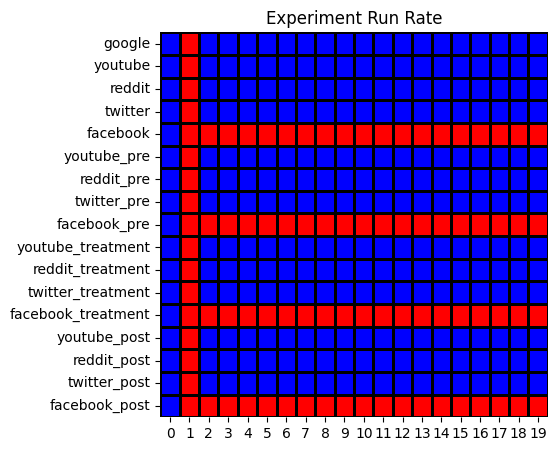

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

# Experiment success rate:
users = list(config['users'].keys())

df = pd.DataFrame()
for user in users:
    try:
        items = json.load(open(os.path.join(data, user, 'items.json'), 'r'))
    except:
        # no file found—add a row of zeros
        items = {k: 0 for k in items}
    df = pd.concat([df, pd.DataFrame(items, index=[user])])

plt.figure(figsize=(5, 5))
sns.heatmap(df.T, cmap=['red', 'blue'], cbar=False, linewidths=1, linecolor='black')
plt.title('Experiment Run Rate')

Text(0.5, 1.0, 'Experiment Success Rate')

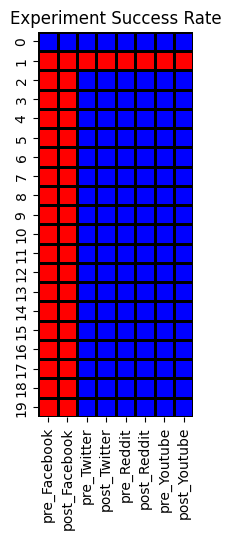

In [7]:
dumps = dict()
for user in users:
    dumps[user] = dict()
    for platform in ['Facebook', 'Twitter', 'Reddit', 'Youtube']:
        try:
            conn = sqlite3.connect(os.path.join(data, user, platform, 'log.db'))
            df = pd.read_sql_query('SELECT * FROM logs', conn)
            pre = df[df['tick'] == -0.25]
            post = df[df['tick'] == 0.25]
            if len(pre) > 0:
                dumps[user][f'pre_{platform}'] = pre['dump'].values[0]
            else:
                dumps[user][f'pre_{platform}'] = None
            if len(post) > 0:
                dumps[user][f'post_{platform}'] = post['dump'].values[0]
            else:
                dumps[user][f'post_{platform}'] = None
        except Exception as e:
            dumps[user][f'pre_{platform}'] = None
            dumps[user][f'post_{platform}'] = None
        

bin_dumps = dict()
for user in dumps:
    bin_dumps[user] = dict()
    for key in dumps[user]:
        if dumps[user][key] is not None:
            bin_dumps[user][key] = 1
        else:
            bin_dumps[user][key] = 0

df = pd.DataFrame(bin_dumps).T

plt.figure(figsize=(2, 5))
sns.heatmap(df, cmap=['red', 'blue'], cbar=False, linewidths=1, linecolor='black')
plt.title('Experiment Success Rate')

In [8]:
import pickle as pkl
pkl.load(open(os.path.join(data, '/Users/hussam/Desktop/Projects/algopologist/analysis/datasets/local/2/treatments/Twitter/1712198409.pkl'), 'rb'))

{'id': 'https://twitter.com/nba_yb_tv/status/1775710599604814097',
 'platform': 'twitter',
 'origin': 'search',
 'position': 0,
 'type': 'post',
 'source': 'nba_yb_tv',
 'secondary_source': None,
 'likes': 39,
 'comments': 4,
 'shares': 6,
 'views': 492,
 'created_at': None,
 'title': 'i think every fanbase can agree that this is the dumbest bitch on this app',
 'description': '',
 'media': 'image',
 'url': 'https://twitter.com/nba_yb_tv/status/1775710599604814097',
 'is_ad': False,
 'name': ''}

In [9]:
users = config['users']
id_name = dict()
name_id = dict()

for id in users:
    name = f"{users[id]['action']}_{users[id]['topic']}_{users[id]['replication']}"
    id_name[id] = name
    name_id[name] = id

In [10]:
treatments = dict()
for user in id_name:
    treatments[id_name[user]] = dict()
    for platform in ['Facebook', 'Twitter', 'Reddit', 'Youtube']:
        try:
            treatment_folder = os.path.join(data, user, 'treatments', platform)
            treatment_file = os.listdir(treatment_folder)[0]
            treatment = pkl.load(open(os.path.join(treatment_folder, treatment_file), 'rb'))
            treatments[id_name[user]][platform] = treatment['title']
        except:
            treatments[id_name[user]][platform] = None

df = pd.DataFrame(treatments).T

Text(0.5, 1.0, 'Observation Success Rate')

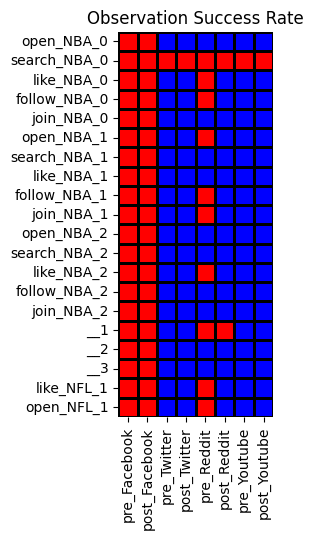

In [11]:
observations = dict()
for user in id_name:
    observations[id_name[user]] = dict()
    for platform in ['Facebook', 'Twitter', 'Reddit', 'Youtube']:
        try:
            pre_file = dumps[user][f'pre_{platform}'].split('\\')[-1]
            post_file = dumps[user][f'post_{platform}'].split('\\')[-1]
            pre = pkl.load(open(os.path.join(data, user, 'observations', platform, pre_file), 'rb'))
            post = pkl.load(open(os.path.join(data, user, 'observations', platform, post_file), 'rb'))
            observations[id_name[user]][f'pre_{platform}'] = pre
            observations[id_name[user]][f'post_{platform}'] = post
        except:
            observations[id_name[user]][f'pre_{platform}'] = None
            observations[id_name[user]][f'post_{platform}'] = None


bin_observations = dict()
for user in observations:
    bin_observations[user] = dict()
    for key in observations[user]:
        if observations[user][key] is not None:
            bin_observations[user][key] = len(observations[user][key])
        else:
            bin_observations[user][key] = 0
    
df = pd.DataFrame(bin_observations).T
df = df > 10

plt.figure(figsize=(2, 5))
sns.heatmap(df, cmap=['red', 'blue'], cbar=False, linewidths=1, linecolor='black')
plt.title('Observation Success Rate')

In [12]:
user = '4'
platform = 'Twitter'

pre_file = dumps[user][f'pre_{platform}'].split('\\')[-1]
post_file = dumps[user][f'post_{platform}'].split('\\')[-1]
pre = pkl.load(open(os.path.join(data, user, 'observations', platform, pre_file), 'rb'))
post = pkl.load(open(os.path.join(data, user, 'observations', platform, post_file), 'rb'))
observations[id_name[user]][f'pre_{platform}'] = pre
observations[id_name[user]][f'post_{platform}'] = post

In [14]:
obs = dict()
# convert observations[user]['pre_platform'] to a dictionary with
# obs[user][platform][time] where time is either pre or post

for user in observations:
    obs[user] = dict()
    for platform in ['Facebook', 'Twitter', 'Reddit', 'Youtube']:
        obs[user][platform] = dict()
        for time in ['pre', 'post']:
            try:
                obs[user][platform][time] = observations[user][f'{time}_{platform}']
            except:
                obs[user][platform][time] = None

In [16]:
import pickle as pkl
pkl.dump(obs, open(os.path.join(data, 'observations-local.pkl'), 'wb'))

In [21]:
name_id['open_NFL_1']

'19'

In [187]:
name_id['open_NFL_1']

'19'

In [36]:
name_id['follow_NBA_2']

'13'

In [26]:
observations[id_name['4']]['post_Twitter'][0]

{'id': 'https://twitter.com/NoContextHumans/status/1775470801061359732',
 'username': 'NoContextHumans',
 'text': '',
 'isAd': False,
 'comments': 199,
 'retweets': 12000,
 'likes': 58000,
 'views': 34000000,
 'attachment': 'image',
 'position': 0}

In [148]:
observations

{'open_NBA_0': {'pre_Facebook': [],
  'post_Facebook': [],
  'pre_Twitter': [{'id': 'https://twitter.com/buitengebieden/status/1775580563484635248',
    'username': 'buitengebieden',
    'text': 'Mommy cat introducing her kitten to her  dog friend.. ',
    'isAd': False,
    'comments': 160,
    'retweets': 3000,
    'likes': 53000,
    'views': 24000000,
    'attachment': 'video',
    'position': 0},
   {'id': 'https://twitter.com/Bubblebathgirl/status/1775381111511691681',
    'username': 'Bubblebathgirl',
    'text': 'How do we stop this?',
    'isAd': False,
    'comments': 22000,
    'retweets': 63000,
    'likes': 14000,
    'views': 34000000,
    'attachment': 'video',
    'position': 1},
   {'id': 'https://twitter.com/ZubyMusic/status/1775402347021115827',
    'username': 'ZubyMusic',
    'text': 'Male sexual discipline is underrated.\n\nThe downfall of many men historically and currently is an inability to control their willies.',
    'isAd': False,
    'comments': 526,
    'r

In [133]:
df

,Facebook,Twitter,Reddit,Youtube
open_NBA_0,NBA Standings \n-GSW win their 5th straight\n-...,None,None,None
search_NBA_0,None,None,None,None
like_NBA_0,None,i think every fanbase can agree that this is t...,Is NBA really boring now?,Cleveland Cavaliers @ Phoenix Suns | NBA on ES...
follow_NBA_0,None,None,None,None
join_NBA_0,None,None,None,None
open_NBA_1,None,None,None,None
search_NBA_1,None,None,None,None
like_NBA_1,None,Jaylen Brown on the Celtics’ ability to respon...,Is NBA really boring now?,Cleveland Cavaliers @ Phoenix Suns | NBA on ES...
follow_NBA_1,None,None,None,None
join_NBA_1,None,None,None,None


In [34]:
logs = dict()
observations = dict()
treatments = config['treatments']
users = []
for treatment in treatments:
    for i in range(config['replication']):
        users.append(f"{treatment['action']}_{treatment['topic']}_{i}")

for platform in platforms:
    db = os.path.join(PATH, 'data', platform, 'log.db')
    conn = sqlite3.connect(db)
    logs[platform] = pd.read_sql_query(f"SELECT * FROM logs", conn)

for platform in platforms:
    observations[platform] = dict()
    l = logs[platform]
    for user in users:
        observations[platform][user] = dict()
        lu = l[l['user'] == user].set_index('tick').to_dict('index')
        file_path = lu.get(-0.25, {}).get('dump', None)
        if file_path:
            observations[platform][user]['pre'] = pd.read_pickle(file_path)
        
        observations[platform][user]['post'] = lu.get(0.25, {}).get('dump', None)

{'Reddit': {'like_oscars_0': {'pre': None, 'post': None},
  '__0': {'pre': None, 'post': None}},
 'YouTube': {'like_oscars_0': {'pre': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\YouTube\\1711039207.pkl',
   'post': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\YouTube\\1711042601.pkl'},
  '__0': {'pre': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\YouTube\\1711040031.pkl',
   'post': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\YouTube\\1711043418.pkl'}},
 'Twitter': {'like_oscars_0': {'pre': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\Twitter\\1711039345.pkl',
   'post': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\Twitter\\1711042727.pkl'},
  '__0': {'pre': 'C:\\Users\\hussa\\Desktop\\algopologist\\trials\\xplocal\\data\\observations\\Twitter\\1711040148.pkl',
   'post': 'C:\\Users

In [19]:
a

,user,platform,time,tick,action,topic,dump,screenshot
0,like_oscars_0,YouTube,1.711039e+09,-0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap0-xplocal-youtube-a39b72b7.png
2,like_oscars_0,YouTube,1.711041e+09,0.00,like,oscars,C:\Users\hussa\Desktop\algopologist\trials\xpl...,
4,like_oscars_0,YouTube,1.711043e+09,0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap0-xplocal-youtube-bcf91d08.png


,,user,time
user,,,
__0,4,__0,1.711044e+09
like_oscars_0,3,like_oscars_0,1.711043e+09


In [21]:
# split logs based on user and get dictionaries
log_dicts = dict()

,platform,time,tick,action,topic,dump,screenshot
user,,,,,,,
__0,3,3,3,3,3,3,3
like_oscars_0,2,2,2,2,2,2,2


In [19]:
logs['YouTube']

,user,platform,time,tick,action,topic,dump,screenshot
0,like_oscars_0,YouTube,1.711039e+09,-0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap0-xplocal-youtube-a39b72b7.png
1,__0,YouTube,1.711040e+09,-0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap1-xplocal-youtube-8cc12d7c.png
2,like_oscars_0,YouTube,1.711041e+09,0.00,like,oscars,C:\Users\hussa\Desktop\algopologist\trials\xpl...,
3,__0,YouTube,1.711042e+09,0.00,,,C:\Users\hussa\Desktop\algopologist\trials\xpl...,
4,like_oscars_0,YouTube,1.711043e+09,0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap0-xplocal-youtube-bcf91d08.png
5,__0,YouTube,1.711043e+09,0.25,observe,home,C:\Users\hussa\Desktop\algopologist\trials\xpl...,xplocalceap1-xplocal-youtube-b0cb8448.png
